In [1]:
import os
import sys
import pandas as pd
import numpy as np
import glob
import time
import gget
import scipy
from scipy.sparse import csr_matrix
import anndata as an
import scanpy as sc
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns
import networkx as nx
import random
from importlib import reload
import warnings
import ot
from scipy.spatial.distance import pdist, squareform
from matplotlib.colors import ListedColormap
from matplotlib.cm import ScalarMappable

import surprise as sup

from sklearn.decomposition import TruncatedSVD
from sklearn.preprocessing import MinMaxScaler

"""WARNING: no warnings"""
warnings.filterwarnings("ignore")

# local imports
import anndata_utils as anntools

source_path = os.path.abspath("../source/")
sys.path.append(source_path)
import centrality as central
import matrix
import utils as ut
import plotting as plt2

In [2]:
resolution = 100000
chrom = "chr11"

dpath = "/scratch/indikar_root/indikar1/shared_data/higher_order/by_chromosome/"

file_list = sorted(glob.glob(f"{dpath}*_{resolution}_{chrom}*"))
population_path = file_list[0]
print(population_path)

start_time = time.time()  # Record the start time
adata = sc.read_h5ad(population_path)
end_time = time.time()  # Record the end time
print(f"Time taken to read the file: {end_time - start_time:.2f} seconds")
sc.logging.print_memory_usage()

# sort the object by global bin id
sorted_indices = adata.obs['bin'].argsort()
adata = adata[sorted_indices, :] 

adata

/scratch/indikar_root/indikar1/shared_data/higher_order/by_chromosome/population_mESC_100000_chr11.h5ad
Time taken to read the file: 1.93 seconds
Memory usage: current 0.83 GB, difference +0.83 GB


View of AnnData object with n_obs × n_vars = 1189 × 88882
    obs: 'bin_index', 'bin_start', 'bin_end', 'bin', 'chrom', 'chrom_bin', 'degree', 'genes', 'n_genes', 'ATACSeq_1', 'ATACSeq_2', 'ATACSeq_3', 'CTCF', 'H3K27ac', 'H3K27me3', 'RNA_1', 'RNA_2', 'RNA_3', 'RNA_4', 'RNA_5', 'RNA_6', 'chrom_degree'
    var: 'read_index', 'basename', 'mean_mapq', 'median_mapq', 'n_chromosomes', 'order', 'n_bins', 'read_length_bp', 'genes', 'n_genes', 'chrom_order'
    uns: 'base_resolution', 'chrom_sizes', 'gene_map'

# Merge in scores

In [3]:
fpath = f"/scratch/indikar_root/indikar1/shared_data/higher_order/core_scores/population_mESC_{resolution}_{chrom}.csv"
df = pd.read_csv(fpath)
print(f"{df.shape=}")

# drop outliers 
df = df.sort_values(by='bin')
columns_to_drop = [x for x in df.columns if x in adata.obs.columns]
df = df.drop(columns=columns_to_drop)
print(f"{df.shape=}")


adata.obs = pd.merge(
    adata.obs, df.set_index('bin_name'),
    how='left',
    left_index=True,
    right_index=True,
)

adata.obs.head()

df.shape=(1186, 33)
df.shape=(1186, 11)


,bin_index,bin_start,bin_end,bin,chrom,chrom_bin,degree,genes,n_genes,ATACSeq_1,...,degree_outlier,ce_singular_vector_1,ce_eigenvector_centrality,ce_betweenness_centrality,ce_pagerank,hge_singular_vector_1,hge_logexp_unweighted,hge_logexp_degree_weighted,hge_logexp_RNA_weighted,hge_logexp_ATAC_weighted
bin_name,,,,,,,,,,,,,,,,,,,,,
chr11:30,12391,3000000,3100000,15283,11,30,1908,Gm11399;Pisd-ps1;Sfi1,3,0.016907,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
chr11:31,18250,3100000,3200000,15284,11,31,6199,Drg1;Sfi1;Gm12735;Eif4enif1;Fau-ps2;Gm11400,6,0.748232,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
chr11:32,6244,3200000,3300000,15285,11,32,418,Gm11944;Limk2;Pik3ip1;Drg1;Gm12592;Patz1,6,0.890719,...,False,0.428770,0.428763,0.015889,0.407474,0.129367,0.994435,0.446523,0.572851,0.854079
chr11:33,12692,3300000,3400000,15286,11,33,416,Rnf185;Gm11948;Limk2,3,0.980228,...,False,0.562541,0.562548,0.118599,0.560645,0.131975,0.993847,0.458922,0.441972,0.916834
chr11:34,12940,3400000,3500000,15287,11,34,405,Smtn;Inpp5j;Gm11946;Rnf185;Pla2g3;Gm11947;8430...,8,0.898549,...,False,0.587206,0.587212,0.018825,0.592804,0.150483,0.989754,0.429140,0.317879,0.813336


In [4]:
def find_outliers_iqr(df_column):
  """
  Identifies outliers in a pandas DataFrame column using the IQR method.

  Args:
    df_column: A pandas Series representing the column to analyze.

  Returns:
    A boolean mask with True for outliers and False otherwise.
  """
  Q1 = df_column.quantile(0.15)
  Q3 = df_column.quantile(0.85)
  IQR = Q3 - Q1
  lower_bound = Q1 - 1.5 * IQR
  upper_bound = Q3 + 1.5 * IQR
  return (df_column < lower_bound) | (df_column > upper_bound)

adata.obs['degree_outlier'] = find_outliers_iqr(adata.obs['chrom_degree'])

# remove outliers
remove_bins = adata.obs[adata.obs['degree_outlier']].index.to_list()
print(f"Removing top {len(remove_bins)} outlier loci: ")
print(remove_bins)
adata = adata[~adata.obs_names.isin(remove_bins), :].copy()

print('done!')

Removing top 3 outlier loci: 
['chr11:30', 'chr11:31', 'chr11:711']
done!


In [5]:
# Clique_expand
matrix.expand_and_normalize_anndata(adata, oe_kr=False)
adata

Expanding input matrix...
Applying KR normalization...
Applying OE normalization...
Normalization complete.


AnnData object with n_obs × n_vars = 1186 × 88882
    obs: 'bin_index', 'bin_start', 'bin_end', 'bin', 'chrom', 'chrom_bin', 'degree', 'genes', 'n_genes', 'ATACSeq_1', 'ATACSeq_2', 'ATACSeq_3', 'CTCF', 'H3K27ac', 'H3K27me3', 'RNA_1', 'RNA_2', 'RNA_3', 'RNA_4', 'RNA_5', 'RNA_6', 'chrom_degree', 'degree_outlier', 'ce_singular_vector_1', 'ce_eigenvector_centrality', 'ce_betweenness_centrality', 'ce_pagerank', 'hge_singular_vector_1', 'hge_logexp_unweighted', 'hge_logexp_degree_weighted', 'hge_logexp_RNA_weighted', 'hge_logexp_ATAC_weighted'
    var: 'read_index', 'basename', 'mean_mapq', 'median_mapq', 'n_chromosomes', 'order', 'n_bins', 'read_length_bp', 'genes', 'n_genes', 'chrom_order'
    uns: 'base_resolution', 'chrom_sizes', 'gene_map'
    obsm: 'A', 'A_kr', 'A_oe'

In [6]:
adata.obs.columns

Index(['bin_index', 'bin_start', 'bin_end', 'bin', 'chrom', 'chrom_bin',
       'degree', 'genes', 'n_genes', 'ATACSeq_1', 'ATACSeq_2', 'ATACSeq_3',
       'CTCF', 'H3K27ac', 'H3K27me3', 'RNA_1', 'RNA_2', 'RNA_3', 'RNA_4',
       'RNA_5', 'RNA_6', 'chrom_degree', 'degree_outlier',
       'ce_singular_vector_1', 'ce_eigenvector_centrality',
       'ce_betweenness_centrality', 'ce_pagerank', 'hge_singular_vector_1',
       'hge_logexp_unweighted', 'hge_logexp_degree_weighted',
       'hge_logexp_RNA_weighted', 'hge_logexp_ATAC_weighted'],
      dtype='object')

Graph with 1186 nodes and 153704 edges


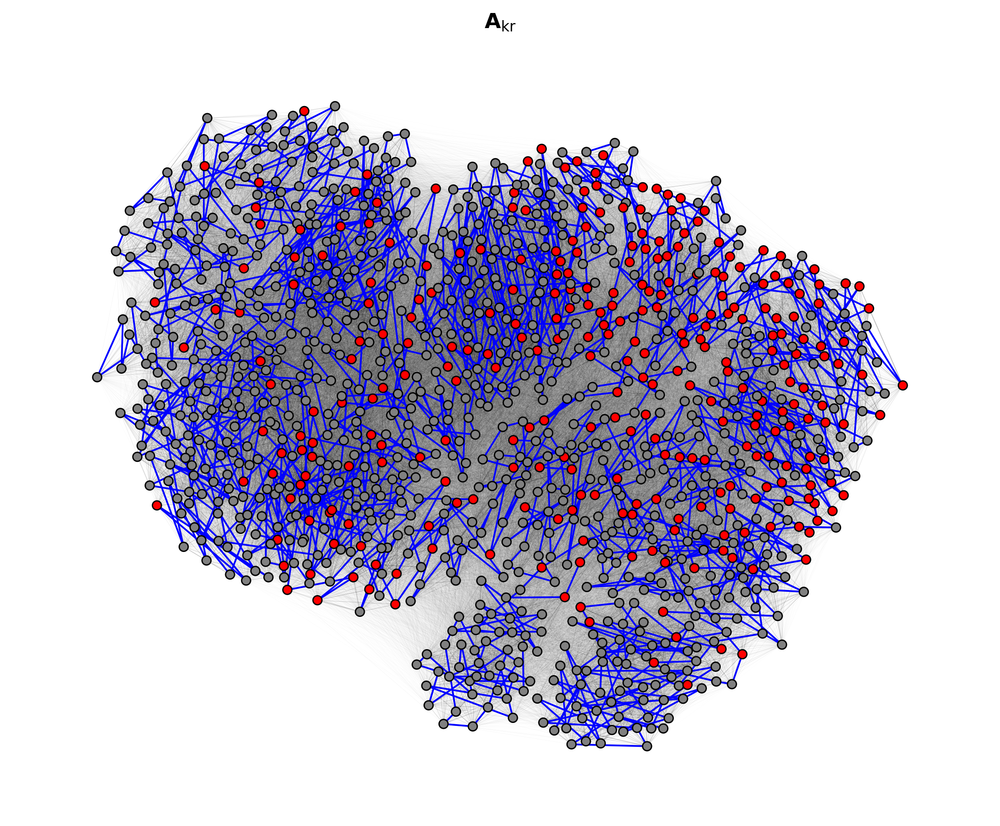

In [15]:
obsm_key = 'A_kr'
core_score = 'hge_logexp_RNA_weighted'
edge_threshold_quantile = 0.65
core_threshold_quantile = 0.75
order_threshold = 2

# plotting params
node_scale = 45
node_edgewidth = 0.75
edge_scale = 1
edge_alpha = 0.15
draw_linear = True

vector = adata.obs[core_score].values
threshold = np.quantile(vector, core_threshold_quantile)
core_nodes = adata.obs[adata.obs[core_score] > threshold].index.to_list()

node_attributes = adata.obs.copy()
node_attributes['core'] = node_attributes.index.isin(core_nodes)
node_attributes = node_attributes.to_dict(orient='index')

# define the graph
A = adata.obsm[obsm_key].copy()
A = A.mask(np.eye(A.shape[0], dtype=bool), 0)
threshold = np.quantile(A, edge_threshold_quantile)
A[A < threshold] = 0
G = nx.from_pandas_adjacency(A)
nx.set_node_attributes(G, node_attributes)

# get consecutive edges
nodes = adata.obs.index.to_list()
ordered_nodes = list(zip(nodes, nodes[1:]))

G.pos = nx.spring_layout(G)
print(G)

node_colors = ['red' if G.nodes[node]['core'] else 'grey' for node in G.nodes]

plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 10, 8

nx.draw_networkx_nodes(
    G, 
    G.pos,
    node_size=len(node_attributes) / node_scale,
    node_color=node_colors,
    edgecolors='black', 
    linewidths=node_edgewidth,      
)

edge_widths = np.asarray([(d['weight']) for u, v, d in G.edges(data=True)])
edge_widths = ut.min_max(edge_widths) * edge_scale

nx.draw_networkx_edges(
    G, 
    G.pos,
    width=edge_widths,
    edge_color='k',
    alpha=edge_alpha,
)

if draw_linear:
    nx.draw_networkx_edges(
        G, 
        G.pos,
        edgelist=ordered_nodes,
        width=1,
        edge_color='blue',
    )

plt.title(r"$\mathbf{A}_{\text{kr}}$")
sns.despine(left=True, bottom=True)

In [ ]:
# break

# OE Normed

In [8]:
# obsm_key = 'A_oe'
# core_score = 'hge_logexp_RNA_weighted'
# edge_threshold_quantile = 0.85
# core_threshold_quantile = 0.75
# order_threshold = 2

# vector = adata.obs[core_score].values
# threshold = np.quantile(vector, core_threshold_quantile)
# core_nodes = adata.obs[adata.obs[core_score] > threshold].index.to_list()

# node_attributes = adata.obs.copy()
# node_attributes['core'] = node_attributes.index.isin(core_nodes)
# node_attributes = node_attributes.to_dict(orient='index')

# # define the graph
# A = adata.obsm[obsm_key].copy()
# A = A.mask(np.eye(A.shape[0], dtype=bool), 0)
# threshold = np.quantile(A, edge_threshold_quantile)
# A[A < threshold] = 0
# G = nx.from_pandas_adjacency(A)
# nx.set_node_attributes(G, node_attributes)

# G.pos = nx.spring_layout(G)
# print(G)

# node_colors = ['red' if G.nodes[node]['core'] else 'grey' for node in G.nodes]

# plt.rcParams['figure.dpi'] = 300
# plt.rcParams['figure.figsize'] = 8, 8

# nx.draw_networkx_nodes(
#     G, 
#     G.pos,
#     node_size=45,
#     node_color=node_colors,
#     edgecolors='black', 
#     linewidths=0.5,      
# )

# nx.draw_networkx_edges(
#     G, 
#     G.pos,
#     width=[(d['weight']*0.1) for u, v, d in G.edges(data=True)],
#     edge_color='k',
#     alpha=0.3,
# )

# nx.draw_networkx_edges(
#     G, 
#     G.pos,
#     edgelist=ordered_nodes,
#     width=1,
#     edge_color='blue',
# )

# plt.title(r"$\mathbf{A}_{\text{oe}}$")
# sns.despine(left=True, bottom=True)

# Plot Features

In [10]:
adata.obs.columns

Index(['bin_index', 'bin_start', 'bin_end', 'bin', 'chrom', 'chrom_bin',
       'degree', 'genes', 'n_genes', 'ATACSeq_1', 'ATACSeq_2', 'ATACSeq_3',
       'CTCF', 'H3K27ac', 'H3K27me3', 'RNA_1', 'RNA_2', 'RNA_3', 'RNA_4',
       'RNA_5', 'RNA_6', 'chrom_degree', 'degree_outlier',
       'ce_singular_vector_1', 'ce_eigenvector_centrality',
       'ce_betweenness_centrality', 'ce_pagerank', 'hge_singular_vector_1',
       'hge_logexp_unweighted', 'hge_logexp_degree_weighted',
       'hge_logexp_RNA_weighted', 'hge_logexp_ATAC_weighted'],
      dtype='object')

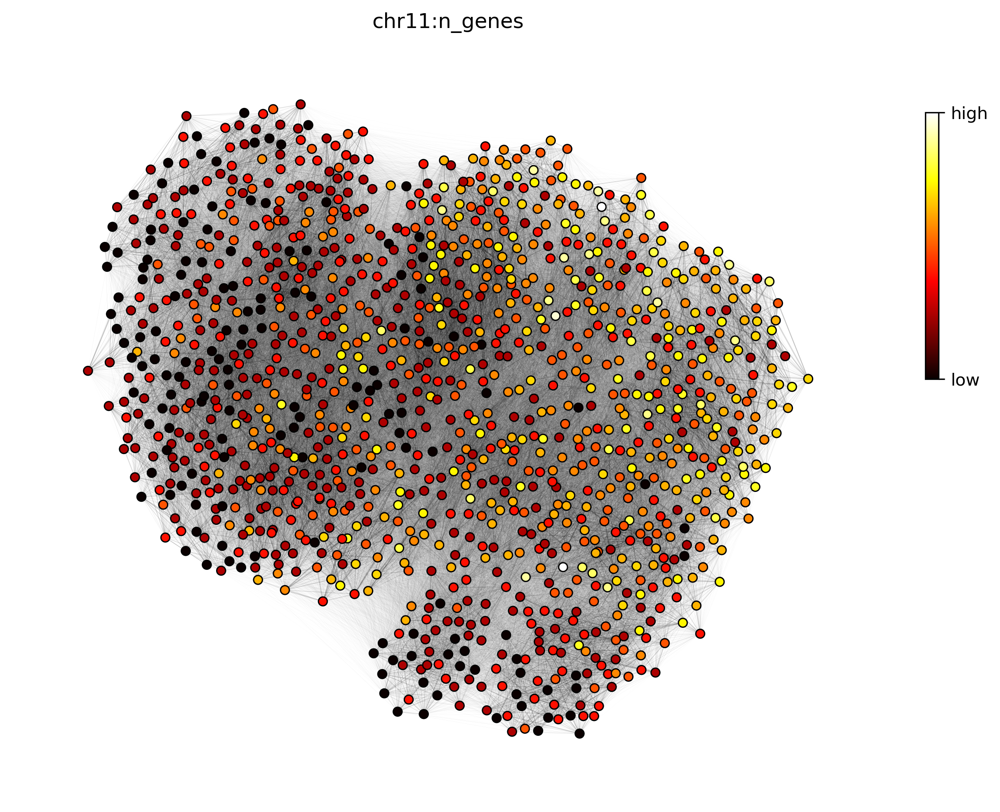

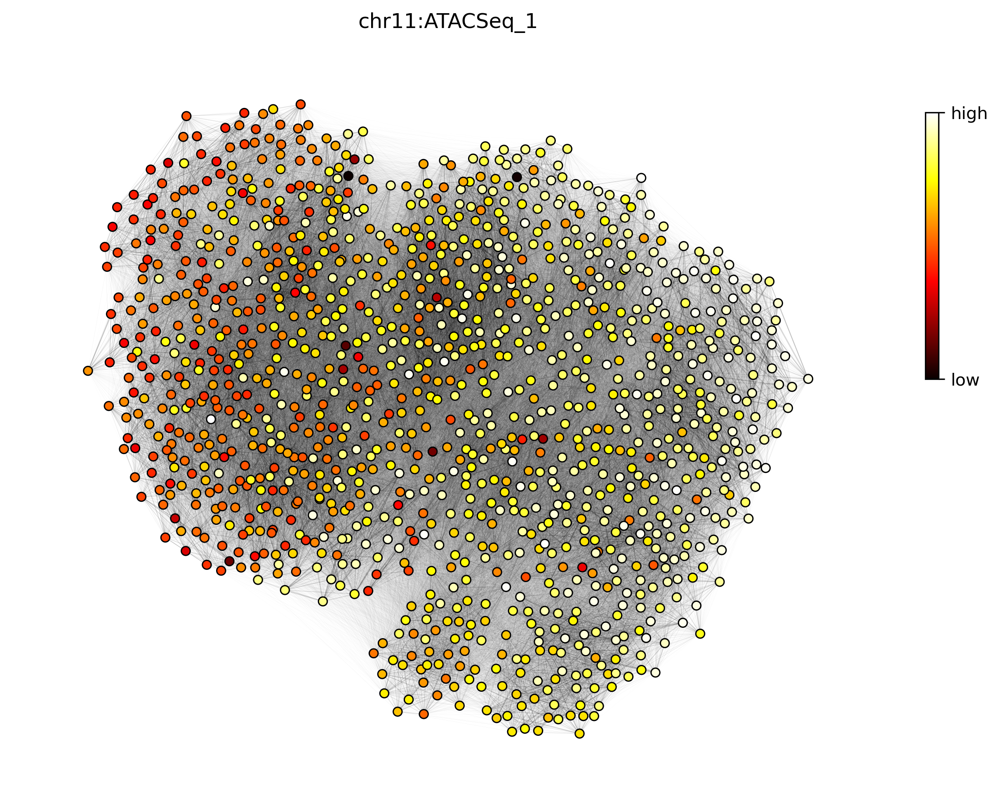

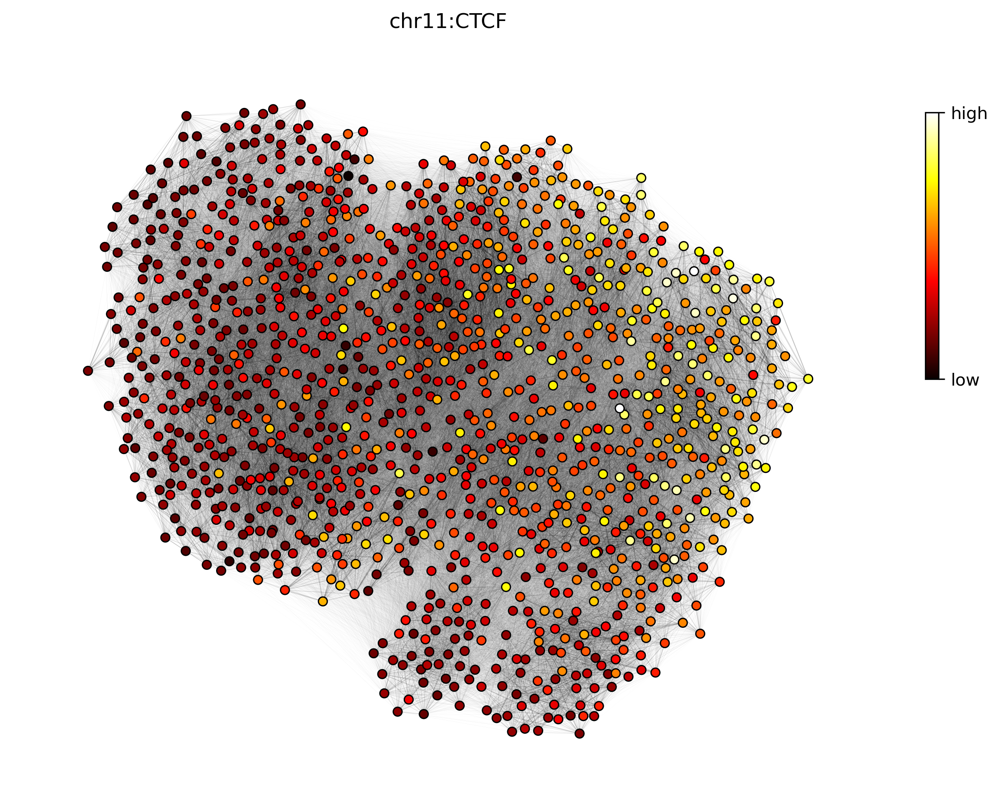

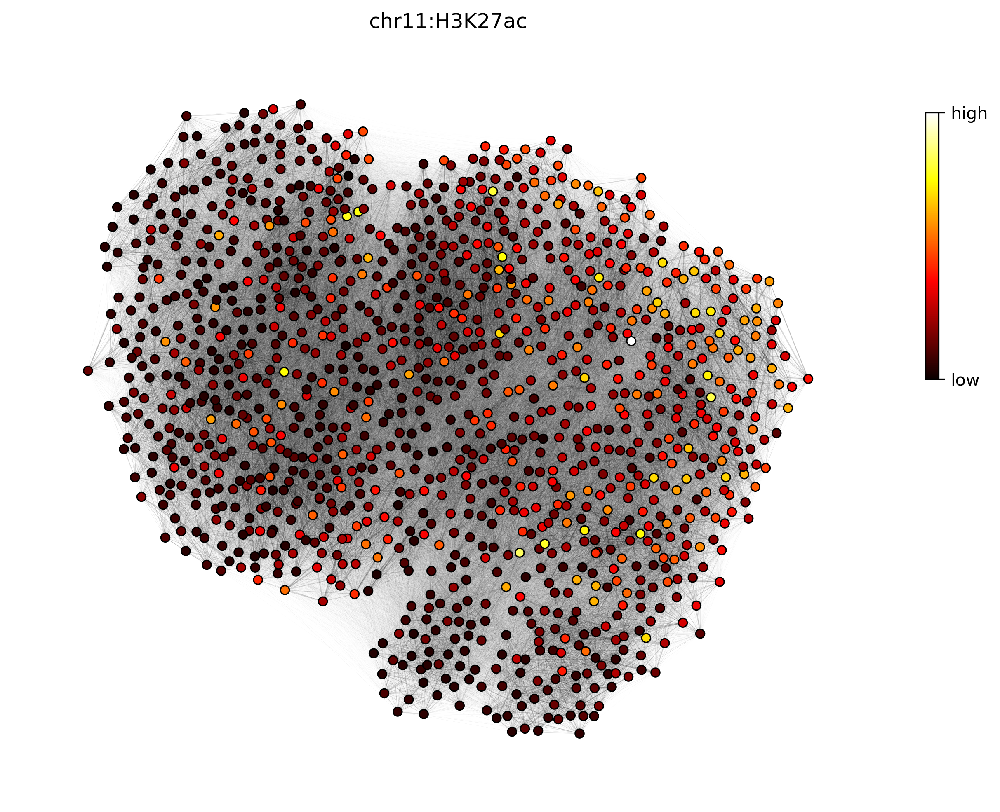

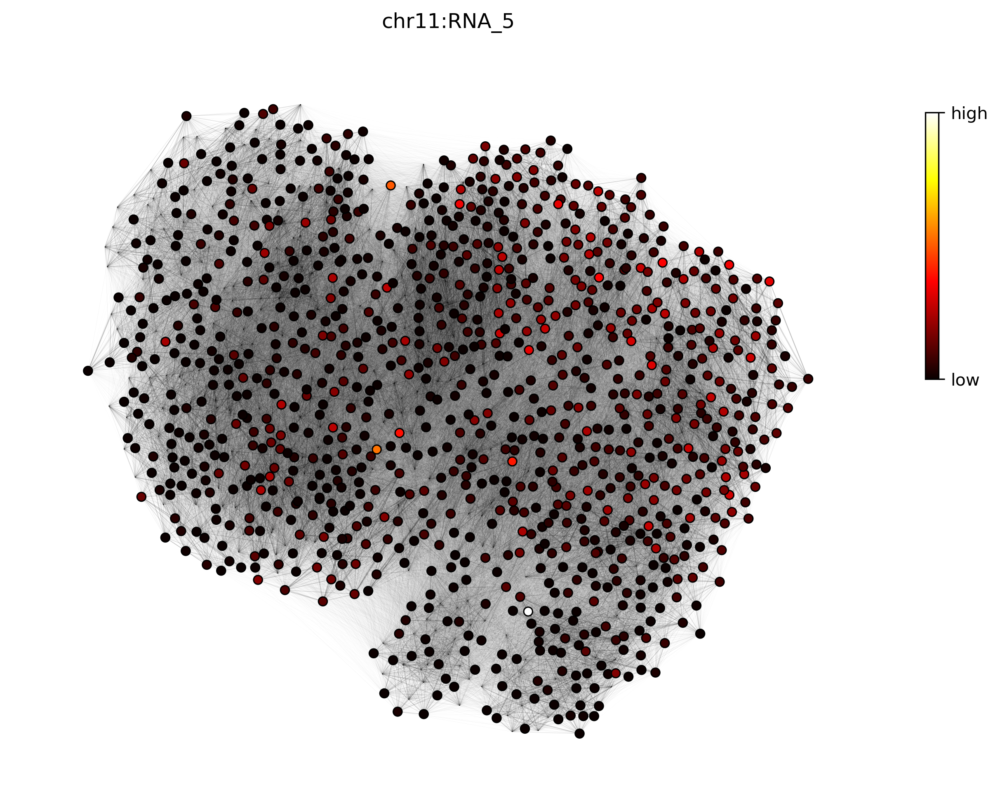

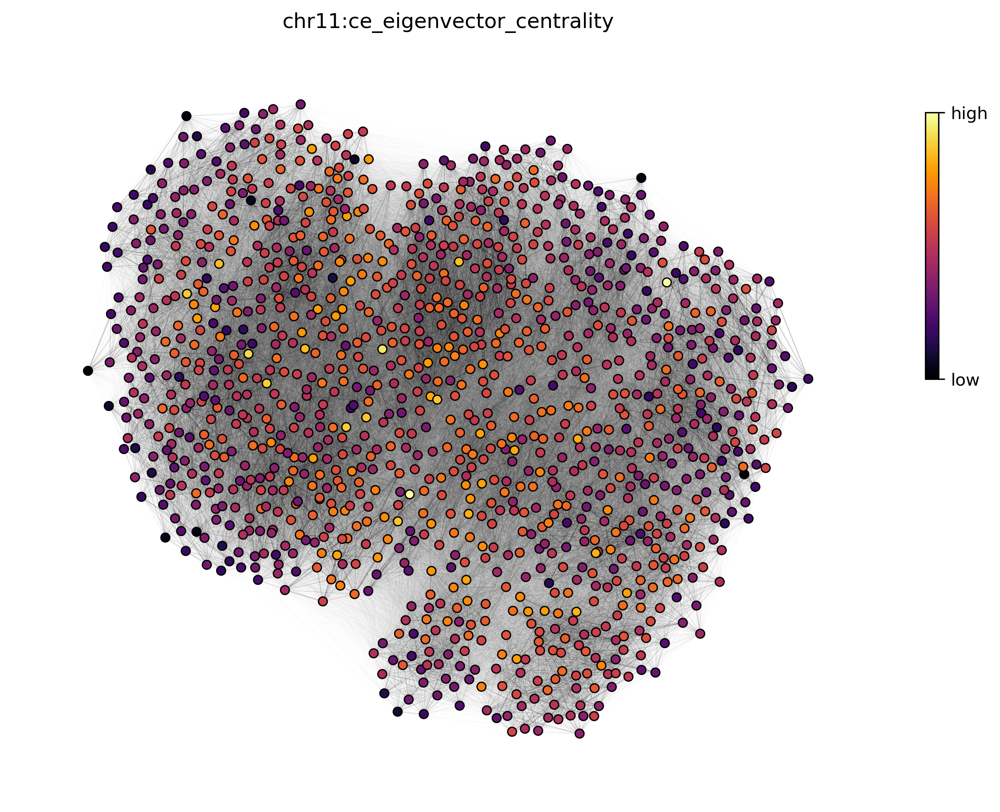

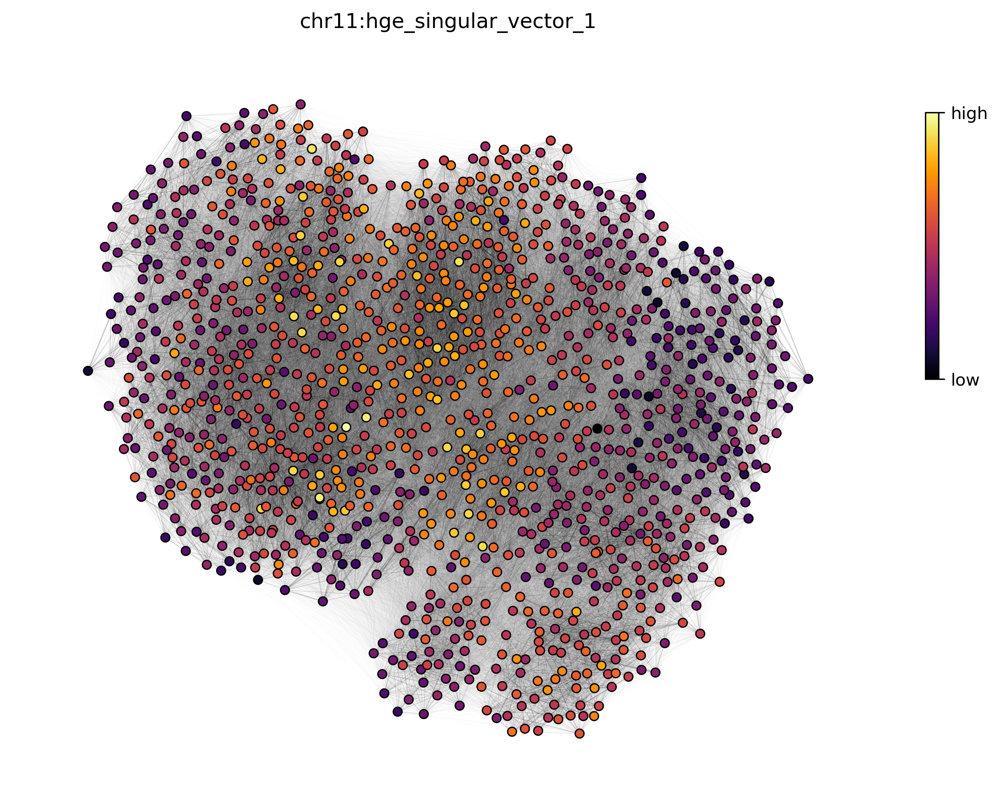

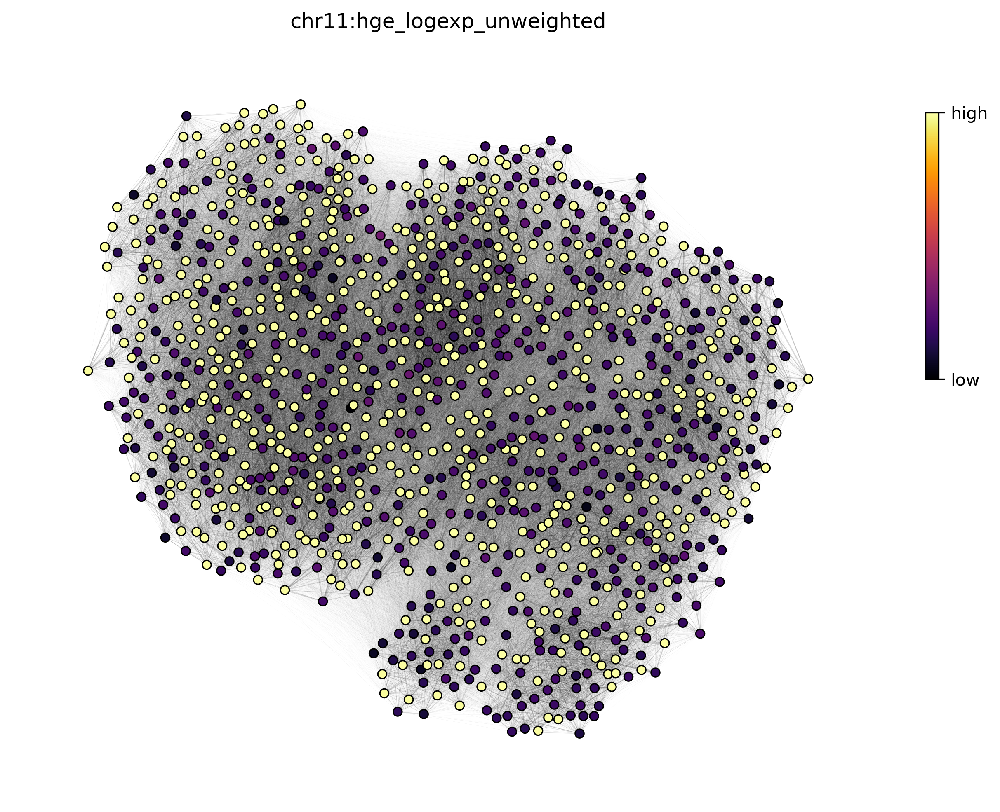

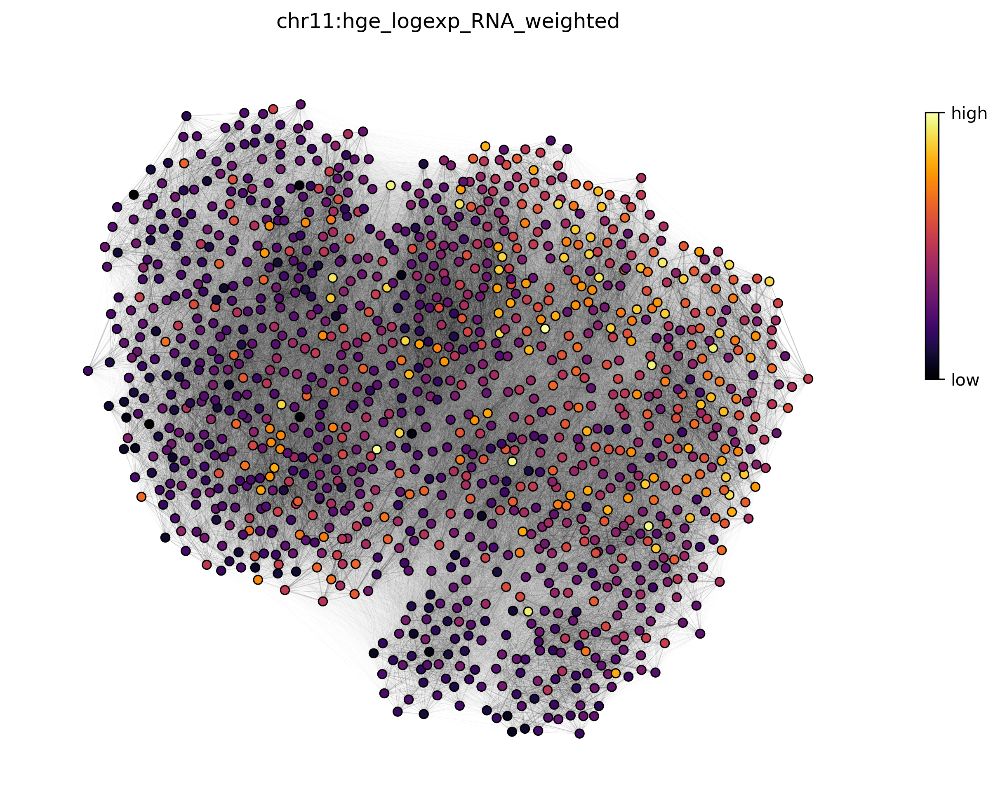

In [17]:
# # plotting params
# node_scale = 4
# node_edgewidth = 0.5
# edge_scale = 5
# edge_alpha = 0.5
draw_linear = False

plot_columns = {
    # 'chrom_degree' : 'hot',
    'n_genes' : 'hot',
    'ATACSeq_1' : 'hot',
    'CTCF' : 'hot',
    'H3K27ac' : 'hot',
    'RNA_5' : 'hot',
    'ce_eigenvector_centrality' : 'inferno',
    'hge_singular_vector_1' : 'inferno',
    'hge_logexp_unweighted' : 'inferno',
    'hge_logexp_RNA_weighted' : 'inferno',
}


for color_by, cmap in plot_columns.items():

    node_colors = [np.log1p(G.nodes[node][color_by]) for node in G.nodes]

    edge_widths = np.asarray([(d['weight']) for u, v, d in G.edges(data=True)])
    edge_widths = ut.min_max(edge_widths) * edge_scale

    plt.rcParams['figure.dpi'] = 300
    plt.rcParams['figure.figsize'] = 10, 8
    
    nx.draw_networkx_nodes(
        G, 
        G.pos,
        node_size=len(node_attributes) / node_scale,
        node_color=node_colors,
        edgecolors='black', 
        linewidths=node_edgewidth,   
        cmap=cmap,
    )
    
    nx.draw_networkx_edges(
        G, 
        G.pos,
        width=edge_widths,
        edge_color='k',
        alpha=edge_alpha,
    )

    if draw_linear:
        nx.draw_networkx_edges(
            G, 
            G.pos,
            edgelist=ordered_nodes,
            width=1,
            edge_color='blue',
        )

    sns.despine(left=True, bottom=True)
    plt.title(f"{chrom}:{color_by}")

    ax = plt.gca()
    divider = make_axes_locatable(ax)
    ax_cbar = divider.append_axes(
        "right", 
        size="10%",
        pad=0.001,
    ) 

    ticks = [min(node_colors), max(node_colors)]
    cbar = plt.colorbar(
        ScalarMappable(
            cmap=cmap, 
            norm=plt.Normalize(vmin=min(node_colors), vmax=max(node_colors))),
        orientation='vertical',
        ax=ax_cbar,
        ticks=ticks,
        shrink=0.35,
        anchor=(0.75, 0.85),
    )

    cbar.ax.set_yticklabels(['low', 'high'])
    ax_cbar.set_visible(False) 
    plt.show()
    # break
    